In [32]:
import tensorflow as tf
import numpy as np
import time
import imageio
import functools
import IPython.display as display
from pathlib import Path
import random
from PIL import Image
from matplotlib import pyplot
import matplotlib.pyplot as plt
import matplotlib as mpl
import os

mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False

### Visualize the input
Define a function to load an image and limit its maximum dimension to 512 pixels.

In [33]:
def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    # in order to use CNN, add one additional dimension 
    # to the original image
    # img shape: [height, width, channel] -> [batch_size, height, width, channel]
    img = img[tf.newaxis, :]
    
    return img

In [34]:
def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

    plt.imshow(image)
    if title:
        plt.title(title)

Image shape: (1, 512, 339, 3)


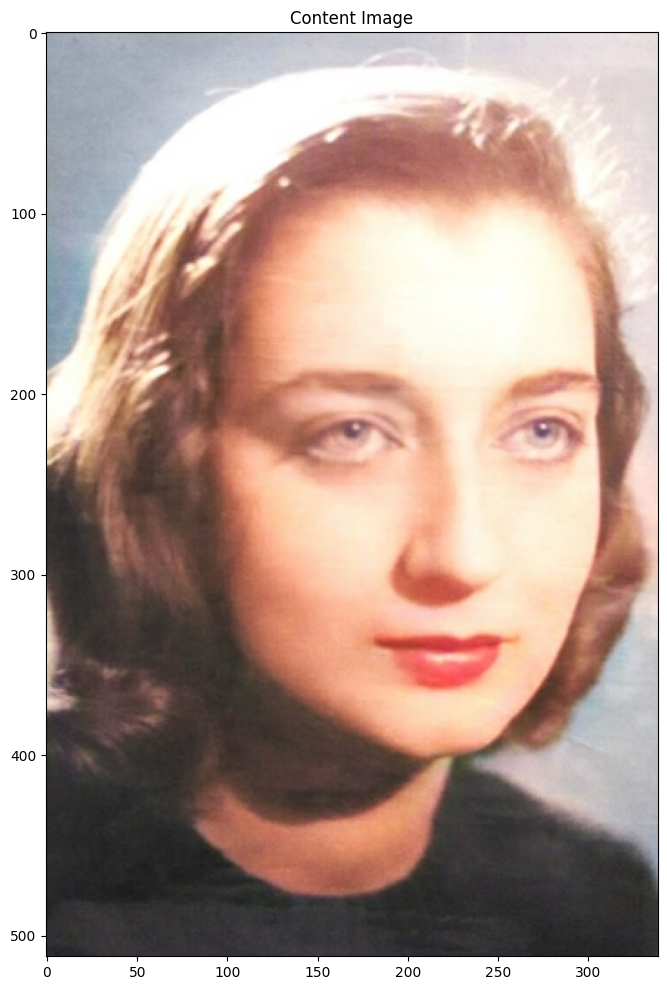

In [35]:
content_path = 'HITA.jpg'
content_image = load_img(content_path)
print('Image shape:', content_image.shape)
imshow(content_image, 'Content Image')

### Cargar una red preentrenada (VGG19)
Vamos a visualizar una de las redes neuronales más notables, VGG19, que se presenta en este artículo , preentrenada en ImageNet. VGG19 es conocida por su simplicidad, ya que utiliza solo capas convolucionales de 3x3 apiladas una sobre otra con una profundidad creciente. El "19" en su nombre representa la cantidad de capas en la red. ImageNet es un gran conjunto de datos utilizado en el Desafío de reconocimiento visual a gran escala de ImageNet (ILSVRC). El conjunto de datos de entrenamiento contiene alrededor de 1,2 millones de imágenes compuestas por 1000 tipos diferentes de objetos. La red preentrenada aprendió a crear representaciones útiles de los datos para diferenciar entre diferentes clases.

La red preentrenada es útil y conveniente para varios usos adicionales, como transferencia de estilo, aprendizaje por transferencia, ajuste fino, etc. En general, el uso de una red preentrenada puede ahorrar mucho tiempo y también facilita el entrenamiento de un modelo en conjuntos de datos más complejos o pequeños.

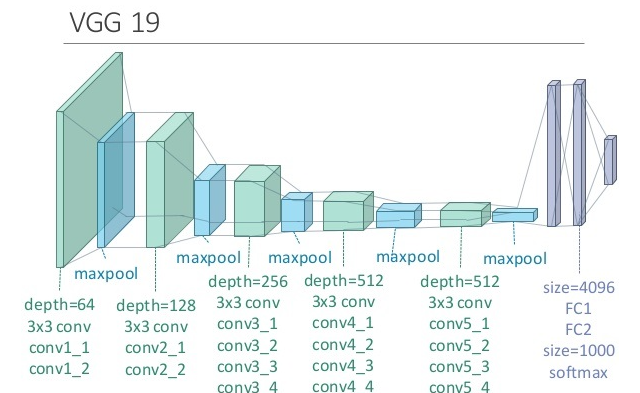

Cargue un VGG19 y ejecútelo en nuestra imagen para asegurarse de que se use correctamente. El resultado de VGG19 son las probabilidades correspondientes a 1000 categorías.


In [36]:
x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x, (224, 224))

# Cargar red preentrenada (VGG19) 
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape

TensorShape([1, 1000])

Obtenga las 5 categorías principales previstas de la imagen de entrada.

In [37]:
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
[(class_name, prob) for (number, class_name, prob) in predicted_top_5]

[('wig', 0.22744001),
 ('fur_coat', 0.11606467),
 ('mask', 0.0330136),
 ('maillot', 0.030305443),
 ('cloak', 0.024476614)]

Vamos primero a imprimir la estructura detallada de VGG19. vgg.summary()Muestra el nombre, la forma de salida y el número de parámetros de cada capa.

In [38]:
vgg.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

### Visualizar filtros
Ahora podemos visualizar los pesos de los filtros de convolución para ayudarnos a comprender lo que ha aprendido la red neuronal. En la terminología de las redes neuronales, los filtros aprendidos son simplemente pesos, pero debido a la estructura bidimensional especializada de los filtros, los valores de peso tienen una relación espacial entre sí y representar gráficamente cada filtro como una imagen bidimensional tiene sentido (o podría tenerlo).

Podemos acceder al bloque de filtros y al bloque de valores de sesgo a través de layer.get_weight(). En VGG19, todas las capas convolucionales utilizan filtros 3x3.

In [39]:
# summarize filter shapes
for layer in vgg.layers:
    # check for convolutional layer
    if 'conv' not in layer.name:
        continue
    # get filter weights
    filters, biases = layer.get_weights()
    print(layer.name, filters.shape)

block1_conv1 (3, 3, 3, 64)
block1_conv2 (3, 3, 64, 64)
block2_conv1 (3, 3, 64, 128)
block2_conv2 (3, 3, 128, 128)
block3_conv1 (3, 3, 128, 256)
block3_conv2 (3, 3, 256, 256)
block3_conv3 (3, 3, 256, 256)
block3_conv4 (3, 3, 256, 256)
block4_conv1 (3, 3, 256, 512)
block4_conv2 (3, 3, 512, 512)
block4_conv3 (3, 3, 512, 512)
block4_conv4 (3, 3, 512, 512)
block5_conv1 (3, 3, 512, 512)
block5_conv2 (3, 3, 512, 512)
block5_conv3 (3, 3, 512, 512)
block5_conv4 (3, 3, 512, 512)


Veamos cada filtro individual en la primera capa convolucional. Veremos los 64 en el bloque y representaremos gráficamente cada uno de los tres canales. Vale la pena mencionar que en la primera capa convolucional, hay un total de 192 mapas de características (64 filtros * 3 canales). Podemos normalizar sus valores en el rango 0-1 para que sean más fáciles de visualizar.

Los cuadrados oscuros indican pesos pequeños o inhibidores y los cuadrados claros representan pesos grandes o excitadores. Usando esta intuición, podemos ver que los filtros en la primera fila detectan un gradiente desde claro en la parte superior izquierda hasta oscuro en la parte inferior derecha.

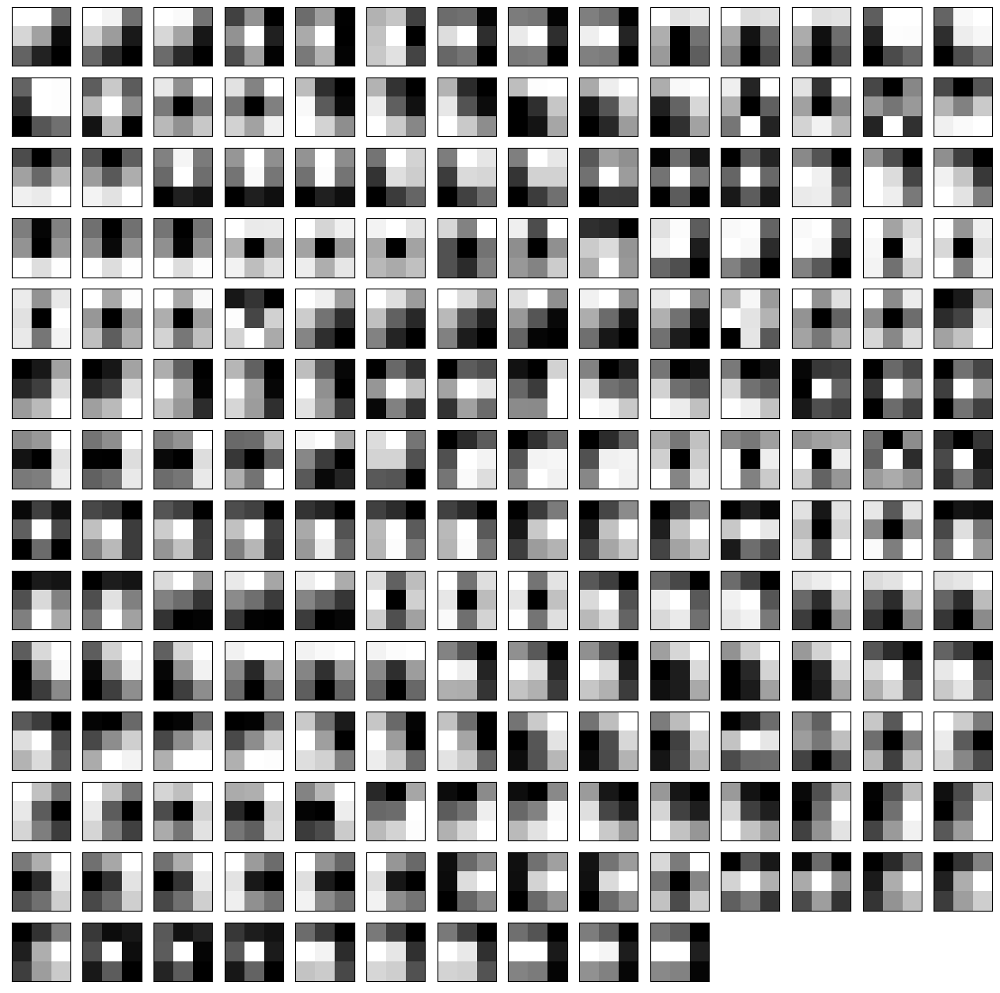

In [40]:
plt.figure(figsize=(16,16))

# retrieve weights from the second hidden layer
filters, biases = vgg.layers[1].get_weights()

# normalize filter values to 0-1 so we can visualize them
f_min, f_max = filters.min(), filters.max()
filters = (filters - f_min) / (f_max - f_min)

# plot first few filters
n_filters, ix = 64, 1

for i in range(n_filters):
    # get the filter
    f = filters[:, :, :, i]
    # plot each channel separately
    for j in range(3):
        # specify subplot and turn of axis
        ax = pyplot.subplot(14, 14, ix)
        ax.set_xticks([])
        ax.set_yticks([])
        # plot filter channel in grayscale
        pyplot.imshow(f[:, :, j], cmap='gray')
        ix += 1
        
# show the figure
pyplot.show()

### Visualizar mapas de características
Los mapas de activación, llamados mapas de características, capturan el resultado de aplicar los filtros a la entrada, como la imagen de entrada u otro mapa de características. La idea de visualizar un mapa de características para una imagen de entrada específica sería entender qué características de la entrada se detectan o se conservan en los mapas de características. La expectativa sería que los mapas de características cercanos a la entrada detecten detalles pequeños o de grano fino, mientras que los mapas de características cercanos a la salida del modelo capturen características más generales.

Podemos observar que el resultado de aplicar los filtros en la primera capa convolucional es una gran cantidad de versiones de la imagen de entrada con diferentes características resaltadas. Por ejemplo, algunas resaltan líneas, otras se enfocan en el fondo o en el primer plano.isualizar mapas de características
Los mapas de activación, llamados mapas de características, capturan el resultado de aplicar los filtros a la entrada, como la imagen de entrada u otro mapa de características. La idea de visualizar un mapa de características para una imagen de entrada específica sería entender qué características de la entrada se detectan o se conservan en los mapas de características. La expectativa sería que los mapas de características cercanos a la entrada detecten detalles pequeños o de grano fino, mientras que los mapas de características cercanos a la salida del modelo capturen características más generales.

Podemos observar que el resultado de aplicar los filtros en la primera capa convolucional es una gran cantidad de versiones de la imagen de entrada con diferentes características resaltadas. Por ejemplo, algunas resaltan líneas, otras se enfocan en el fondo o en el primer plano.

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 1,792
Non-trainable params: 0
_________________________________________________________________


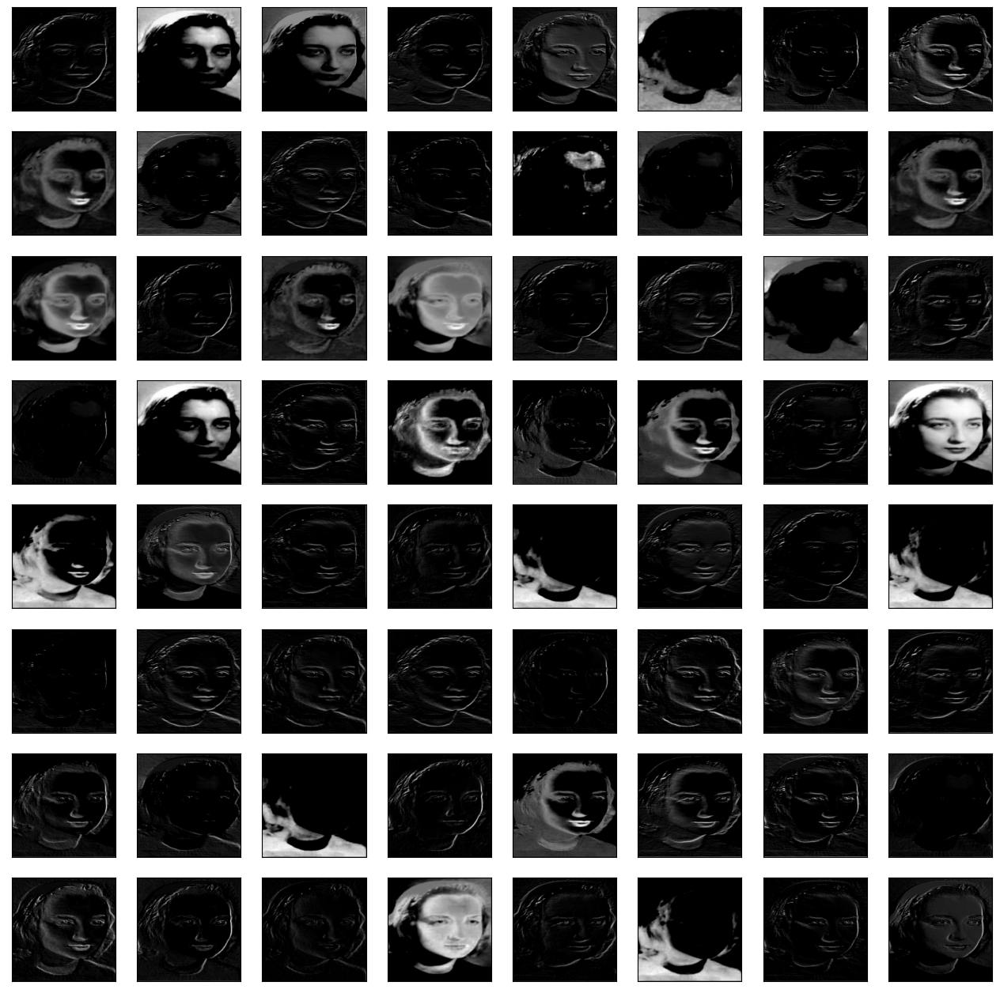

In [41]:
plt.figure(figsize=(16,16))

# redefine model to output right after the first hidden layer
model = tf.keras.Model(inputs=[vgg.input], outputs=vgg.layers[1].output)
model.summary()

# preprocess input
content_image = tf.keras.applications.vgg19.preprocess_input(content_image*255)
content_image = tf.image.resize(content_image, (224, 224))

# get feature map for first hidden layer
feature_maps = model.predict(content_image)

# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
    for _ in range(square):
        # specify subplot and turn of axis
        ax = pyplot.subplot(square, square, ix)
        ax.set_xticks([])
        ax.set_yticks([])
        # plot filter channel in grayscale
        pyplot.imshow(feature_maps[0, :, :, ix-1], cmap='gray')
        ix += 1
        
# show the figure
pyplot.show()
Model: "model"

Visualicemos los mapas de características resultantes de cada bloque del modelo. Es posible que notes que la cantidad de mapas de características (por ejemplo, profundidad o cantidad de canales) en las capas más profundas es mucho mayor que 64, como 256 o 512. Sin embargo, podemos limitar la cantidad de mapas de características visualizados a 64 para mantener la coherencia.

Podemos ver que los mapas de características más cercanos a la entrada del modelo capturan muchos detalles finos en la imagen y que a medida que avanzamos más profundamente en el modelo, los mapas de características muestran cada vez menos detalles.

Este patrón era de esperar, ya que el modelo abstrae las características de la imagen en conceptos más generales que se pueden utilizar para hacer una clasificación. Aunque no está claro en la imagen final que el modelo vio el campus de NTHU, generalmente perdemos la capacidad de interpretar estos mapas de características más profundos.

KerasTensor(type_spec=TensorSpec(shape=(None, 224, 224, 64), dtype=tf.float32, name=None), name='block1_conv2/Relu:0', description="created by layer 'block1_conv2'")


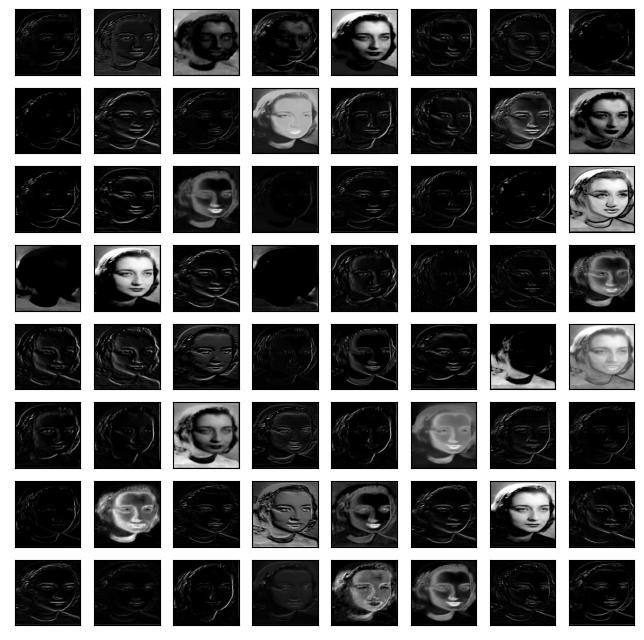

KerasTensor(type_spec=TensorSpec(shape=(None, 112, 112, 128), dtype=tf.float32, name=None), name='block2_conv2/Relu:0', description="created by layer 'block2_conv2'")


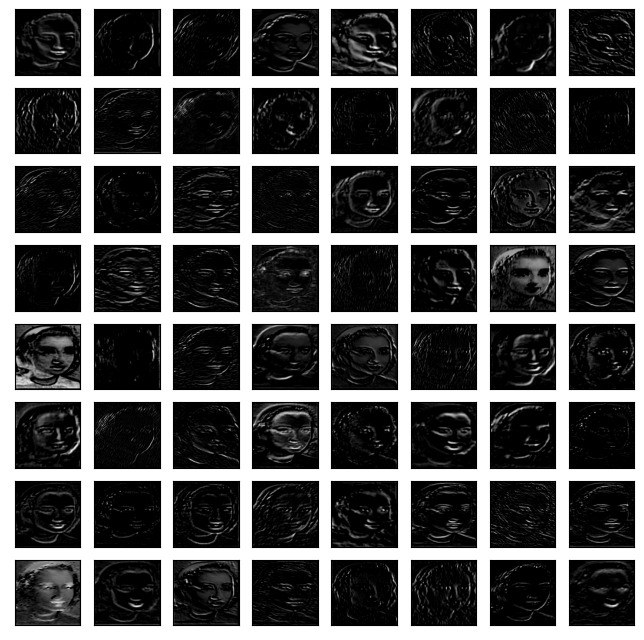

KerasTensor(type_spec=TensorSpec(shape=(None, 56, 56, 256), dtype=tf.float32, name=None), name='block3_conv4/Relu:0', description="created by layer 'block3_conv4'")


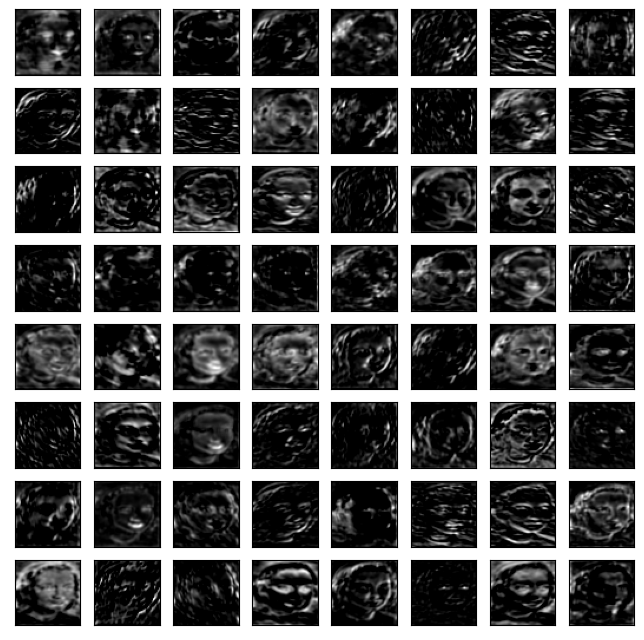

KerasTensor(type_spec=TensorSpec(shape=(None, 28, 28, 512), dtype=tf.float32, name=None), name='block4_conv4/Relu:0', description="created by layer 'block4_conv4'")


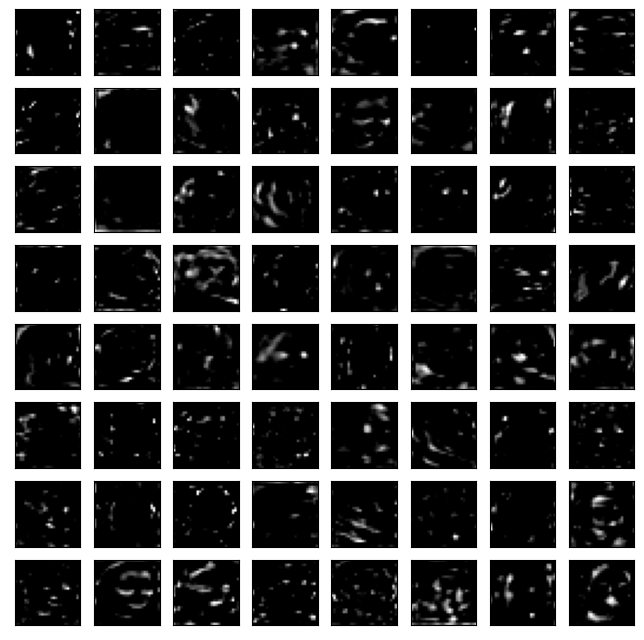

KerasTensor(type_spec=TensorSpec(shape=(None, 14, 14, 512), dtype=tf.float32, name=None), name='block5_conv4/Relu:0', description="created by layer 'block5_conv4'")


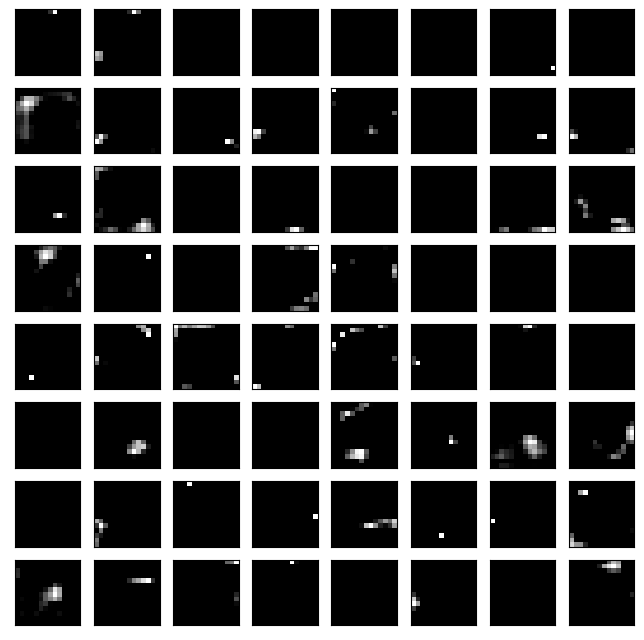

In [42]:
# get feature maps for last convolutional layer in each block
ixs = [2, 5, 10, 15, 20]
outputs = [vgg.layers[i].output for i in ixs]
model = tf.keras.Model(inputs=[vgg.input], outputs=outputs)
feature_maps = model.predict(content_image)

# plot the output from each block
square = 8
for i, fmap in enumerate(feature_maps):
    # plot all 64 maps in an 8x8 squares
    ix = 1
    print(outputs[i])
    plt.figure(figsize=(8,8))
    for _ in range(square):
        for _ in range(square):
            # specify subplot and turn of axis
            ax = pyplot.subplot(square, square, ix)
            ax.set_xticks([])
            ax.set_yticks([])
            # plot filter channel in grayscale
            pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
            ix += 1
            
    # show the figure
    pyplot.show()

### Visualizar gradientes
Visualizar la salida convolucional es una técnica bastante útil para visualizar capas de convolución superficiales, pero cuando llegamos a las capas más profundas, es difícil entenderlas simplemente mirando la salida de convolución.

Si queremos entender qué están haciendo realmente las capas más profundas, podemos intentar utilizar la retropropagación para que nos muestre los gradientes de una neurona en particular con respecto a nuestra imagen de entrada. Realizaremos un pase hacia adelante hasta la capa que nos interesa y luego realizaremos la retropropagación para ayudarnos a entender qué píxeles contribuyeron más a la activación de esa capa.

Primero creamos una operación que encontrará el máximo de neuronas entre todas las activaciones en la capa requerida y luego calcularemos el gradiente de ese objetivo con respecto a la imagen de entrada.

In [43]:
def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

In [44]:
class GradientModel(tf.keras.models.Model):
    def __init__(self, layers):
        super(GradientModel, self).__init__()
        self.vgg =  vgg_layers(layers)
        self.num_style_layers = len(layers)
        self.vgg.trainable = False
        
    # return the feature map of required layer
    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        return outputs

Calcule el gradiente de neuronas máximas entre todas las activaciones en la capa requerida con respecto a la imagen de entrada.

In [45]:
@tf.function()
def visualize_gradient(image):
    with tf.GradientTape() as tape:
        feature = extractor(image)
        # grad = d_feature/d_image
        grad = tape.gradient(tf.reduce_max(feature, axis=3), image)
    return grad

In [46]:
content_image = load_img(content_path)

# activation layer
layers = ['block4_conv2']
image = tf.Variable(content_image)

extractor = GradientModel(layers)
grad = visualize_gradient(image)

# look at the range of gradients
print("shape: ", grad.numpy().shape)
print("min: ", grad.numpy().min())
print("max: ", grad.numpy().max())
print("mean: ", grad.numpy().mean())

shape:  (1, 512, 339, 3)
min:  -19423.656
max:  15834.031
mean:  3.8163593


Es difícil comprender el gradiente en ese rango de valores. Podemos normalizar el gradiente de una manera que nos permita verlo más en términos del rango normal de valores de color. Después de normalizar los valores del gradiente, visualicemos la imagen original y la salida del gradiente retropropagado.

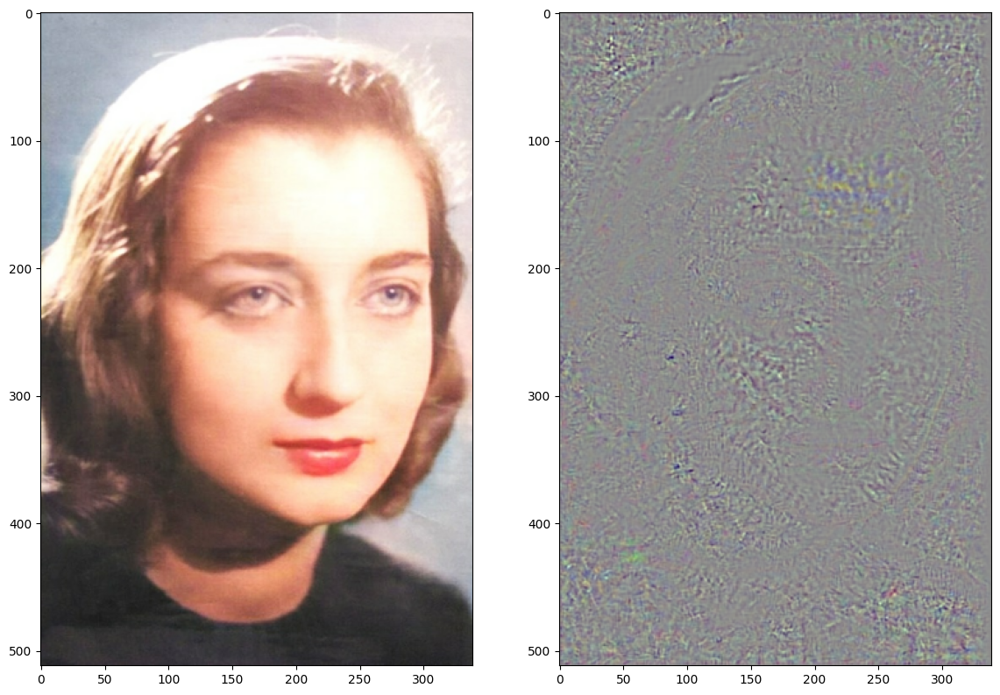

In [47]:
# normalize filter values to 0-1 so we can visualize them
g_min, g_max = grad.numpy().min(), grad.numpy().max()
filters = (grad - g_min) / (g_max - g_min)

plt.figure(figsize=(14,10))
plt.subplot(1, 2, 1)
imshow(image.read_value()[0])

plt.subplot(1, 2, 2)
imshow(filters[0])

También podemos visualizar el gradiente de cualquier mapa de características individual.

In [48]:
@tf.function()
def visualize_gradient_single_layer(image, layer_i):
    with tf.GradientTape() as tape:
        feature = extractor(image)
        grad = tape.gradient(tf.reduce_mean(feature[:, :, :, layer_i]), image)
    return grad

<Figure size 1400x1000 with 0 Axes>

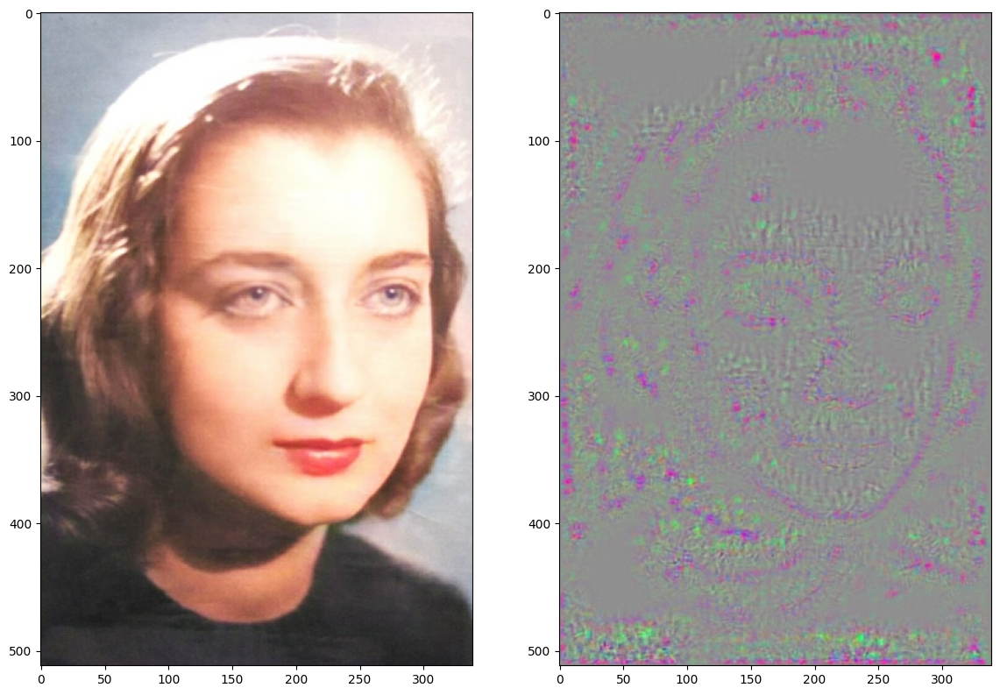

In [49]:
plt.figure(figsize=(14,10))

grad = visualize_gradient_single_layer(image, 77)

# normalize filter values to 0-1 so we can visualize them
g_min, g_max = grad.numpy().min(), grad.numpy().max()
filters = (grad - g_min) / (g_max - g_min)

plt.figure(figsize=(14,10))
plt.subplot(1, 2, 1)
imshow(image.read_value()[0])

plt.subplot(1, 2, 2)
imshow(filters[0])

### Retropropagación guiada
Como podemos ver arriba, los resultados son aún difíciles de explicar y no muy satisfactorios. Cada píxel influye en la neurona a través de múltiples neuronas ocultas.

Idealmente, las neuronas actúan como detectores de características particulares de la imagen. Solo nos interesan las características de la imagen que detecta la neurona, no el tipo de cosas que no detecta. Por lo tanto, al propagar el gradiente, establecemos todos los gradientes negativos en 0.

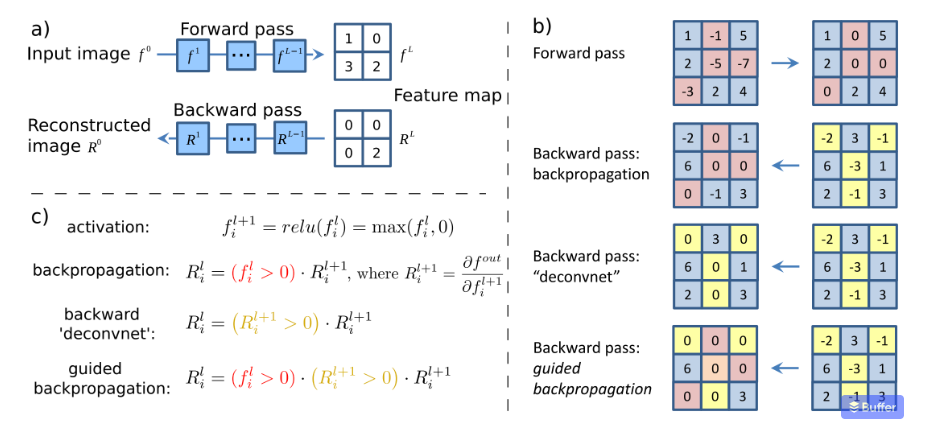


Llamamos a este método retropropagación guiada , porque añade una señal de guía adicional desde las capas superiores a la retropropagación habitual. Esto evita el flujo inverso de gradientes negativos, correspondientes a las neuronas que disminuyen la activación de la unidad de capa superior que pretendemos visualizar. Para obtener más detalles, consulte Striving for Simplicity: The All Convolutional Net , un excelente trabajo de JT Springenberg y A. Dosovitskiy et al.

## A Neural Algorithm of Artistic Style
La visualización de redes neuronales nos permite comprender mejor lo que sucede en esa enorme y misteriosa red. Además de esta aplicación, Leon Gatys y sus coautores tienen un trabajo muy interesante llamado "Un algoritmo neuronal de estilo artístico" que utiliza representaciones neuronales para separar y recombinar el contenido y el estilo de imágenes arbitrarias, proporcionando un algoritmo neuronal para la creación de imágenes artísticas.

### Definir representaciones de contenido y estilo.
Utilice las capas intermedias del modelo para obtener las representaciones de contenido y estilo de la imagen. A partir de la capa de entrada de la red, las activaciones de las primeras capas representan características de bajo nivel, como bordes y texturas. A medida que avanza por la red, las últimas capas representan características de nivel superior (partes de objetos, como ruedas u ojos). En este caso, está utilizando la arquitectura de red VGG19, una red de clasificación de imágenes entrenada previamente. Estas capas intermedias son necesarias para definir la representación de contenido y estilo de las imágenes. Para una imagen de entrada, intente hacer coincidir las representaciones de destino de estilo y contenido correspondientes en estas capas intermedias.



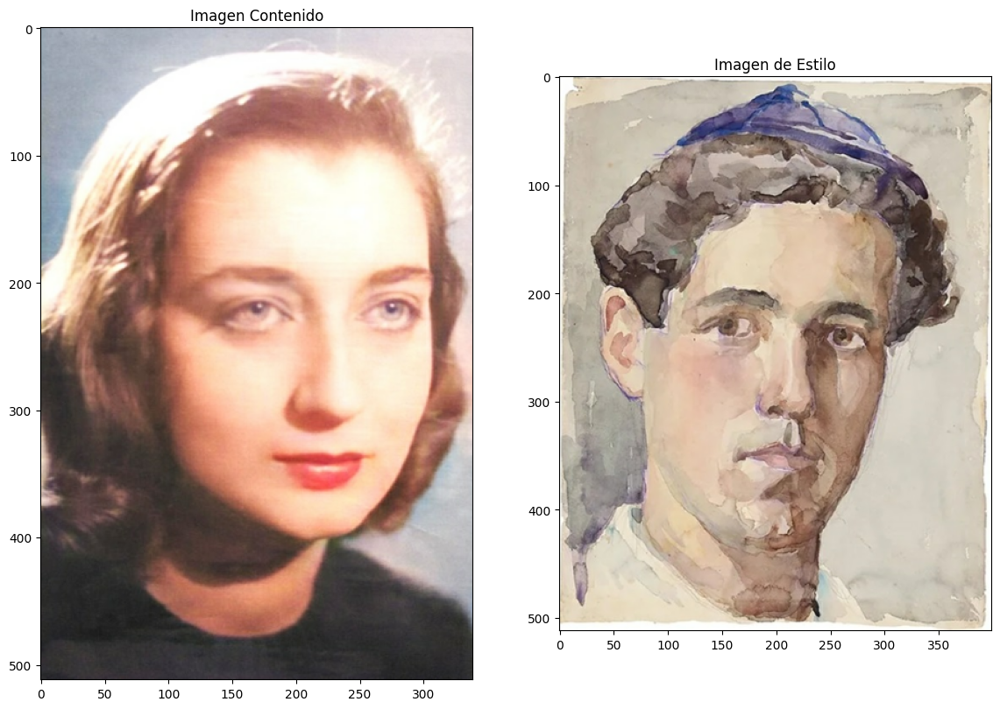

In [50]:
content_path = 'HITA.jpg'
# style_path = 'Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg'
style_path = 'E4.jpg'
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.figure(figsize=(14,10))
plt.subplot(1, 2, 1)
imshow(content_image, 'Imagen Contenido')

plt.subplot(1, 2, 2)
imshow(style_image, 'Imagen de Estilo')

Ahora cargue un VGG19 sin el cabezal de clasificación y enumere los nombres de las capas.

In [51]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
    print(layer.name)



input_8
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


Las características de contenido de la imagen de contenido se calculan introduciendo la imagen de contenido en la red neuronal y extrayendo las activaciones de aquellas content_layers.

Para las características de estilo, extraemos la correlación de las características de la imagen de estilo por capas (matriz de Gram). Al sumar las correlaciones de características de múltiples capas, que corresponden a style_layers, obtenemos una representación multiescala de la imagen de entrada, que captura su información de textura en lugar de la disposición de los objetos en la imagen de entrada.

In [52]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layer of interest
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

En un nivel alto, para que una red pueda realizar una clasificación de imágenes (para lo que se ha entrenado a esta red), debe comprender la imagen. Esto requiere tomar la imagen en bruto como píxeles de entrada y construir una representación interna que convierta los píxeles de la imagen en bruto en una comprensión compleja de las características presentes en la imagen.

Esta es también una razón por la que las redes neuronales convolucionales pueden generalizar bien: pueden capturar las invariancias y las características definitorias dentro de las clases (por ejemplo, gatos frente a perros) que son independientes del ruido de fondo y otras molestias. Por lo tanto, entre la imagen sin procesar que se introduce en el modelo y el resultado, en este caso, la etiqueta predicha, el modelo actúa como un extractor de características complejo. Al acceder a las capas intermedias del modelo, se puede describir el contenido y el estilo de las imágenes de entrada.

### Construir el modelo
Las redes en tf.keras.applications están diseñadas para que puedas extraer fácilmente los valores de la capa intermedia utilizando la API funcional de Keras.

Para definir un modelo utilizando la API funcional, especifique las entradas y salidas:
model = Model(inputs, outputs)

In [53]:
def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

In [54]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
    print(name)
    print("  shape: ", output.numpy().shape)
    print("  min: ", output.numpy().min())
    print("  max: ", output.numpy().max())
    print("  mean: ", output.numpy().mean())
    print()

block1_conv1
  shape:  (1, 512, 399, 64)
  min:  0.0
  max:  875.247
  mean:  30.054546

block2_conv1
  shape:  (1, 256, 199, 128)
  min:  0.0
  max:  3725.9111
  mean:  160.89925

block3_conv1
  shape:  (1, 128, 99, 256)
  min:  0.0
  max:  11013.123
  mean:  131.51651

block4_conv1
  shape:  (1, 64, 49, 512)
  min:  0.0
  max:  17431.719
  mean:  574.6472

block5_conv1
  shape:  (1, 32, 24, 512)
  min:  0.0
  max:  2272.2832
  mean:  42.08337



### Calcular estilo
El estilo de una imagen se puede describir mediante las medias y las correlaciones entre los diferentes mapas de características. Calcule una matriz de Gram que incluya esta información tomando el producto externo del vector de características consigo mismo en cada ubicación y promediando ese producto externo en todas las ubicaciones. Esta matriz de Gram se puede calcular para una capa particular como:
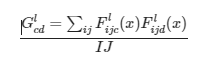

In [55]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

### Extraer estilo y contenido

In [56]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg =  vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name:value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}

In [57]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

style_results = results['style']

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.0014400891
    max:  62370.945
    mean:  329.61755

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  63637.688
    mean:  8824.465

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.57828647
    max:  184765.9
    mean:  8294.762

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  1833110.1
    mean:  126538.37

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  72625.836
    mean:  853.1352

Contents:
   block5_conv2
    shape:  (1, 32, 21, 512)
    min:  0.0
    max:  820.1277
    mean:  10.794331


In [58]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

### Run gradient descent

In [59]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [60]:
@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)

    # tape.gradient: d_loss/d_image
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

In [61]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

image = tf.Variable(content_image)
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
style_weight = 1    # Change it as you want
content_weight = 0  # Change it as you want

# train_step(image)
# plt.imshow(image.read_value()[0])

start = time.time()

epochs = 40
steps_per_epoch = 10

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
    imshow(image.read_value())
    plt.title("Iteracciones: {}".format(step))
    plt.show()
    

end = time.time()
print("Tiempo Total: {:.1f}".format(end-start)) 

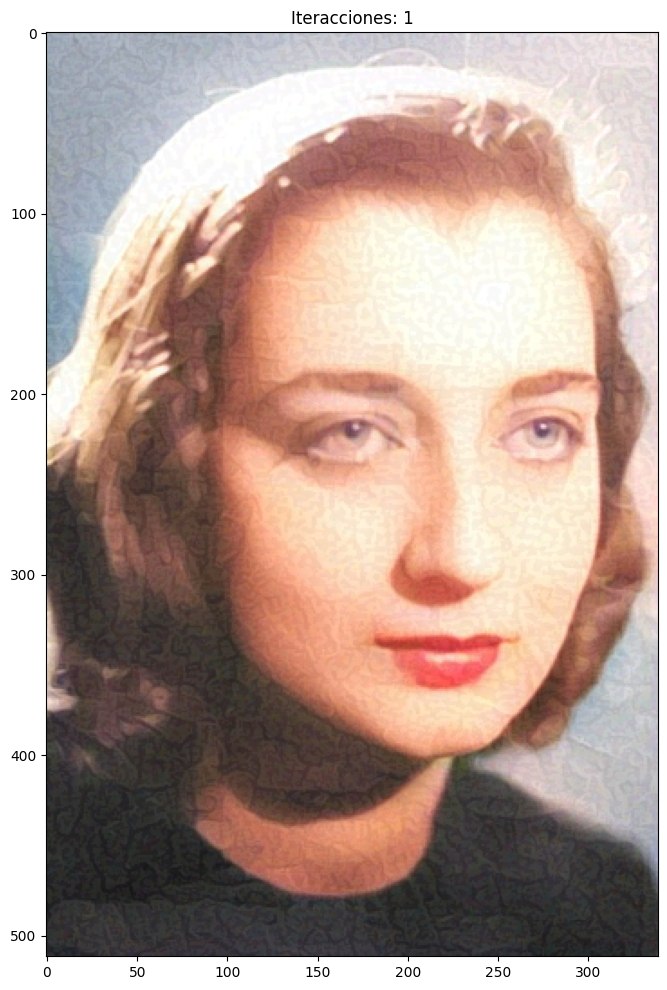

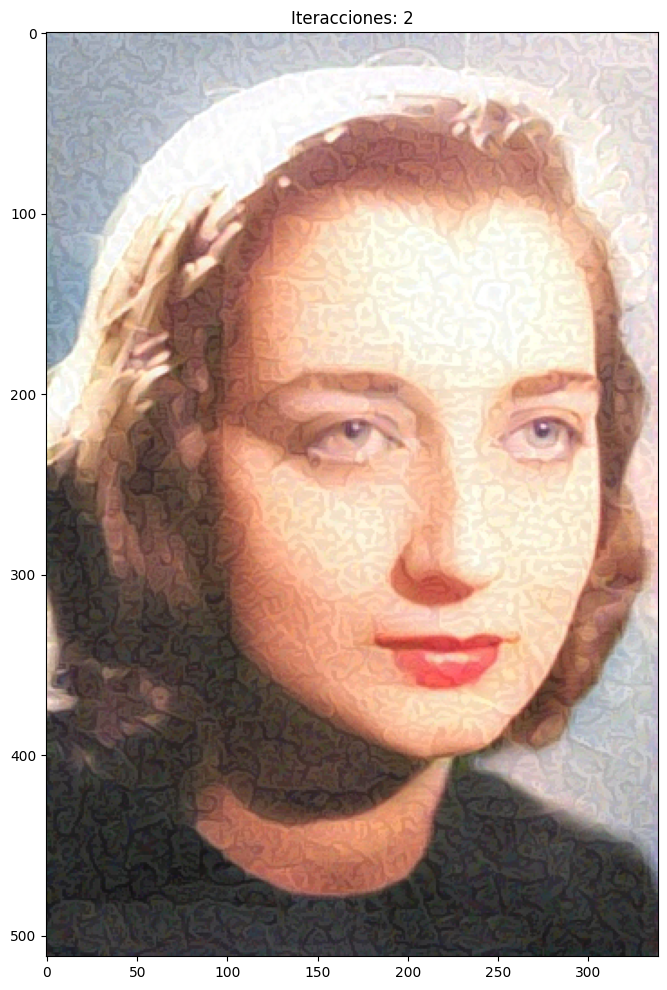

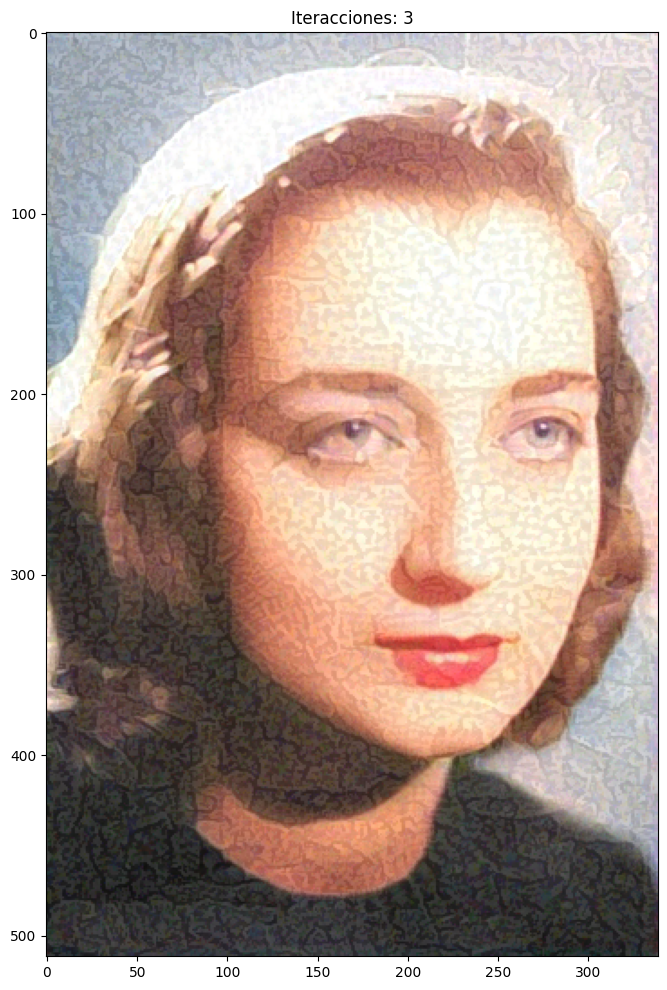

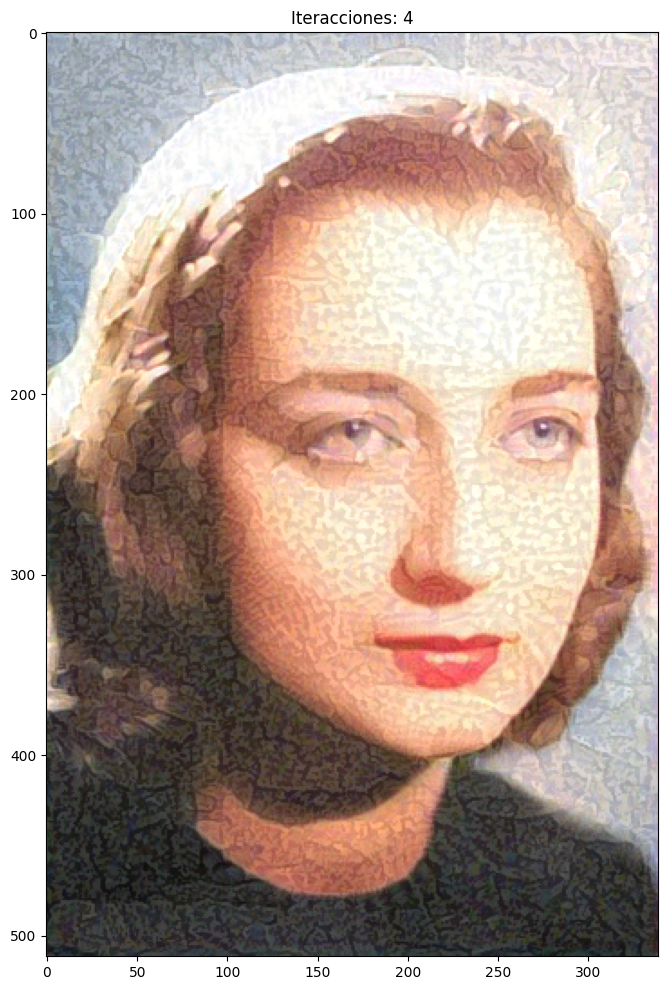

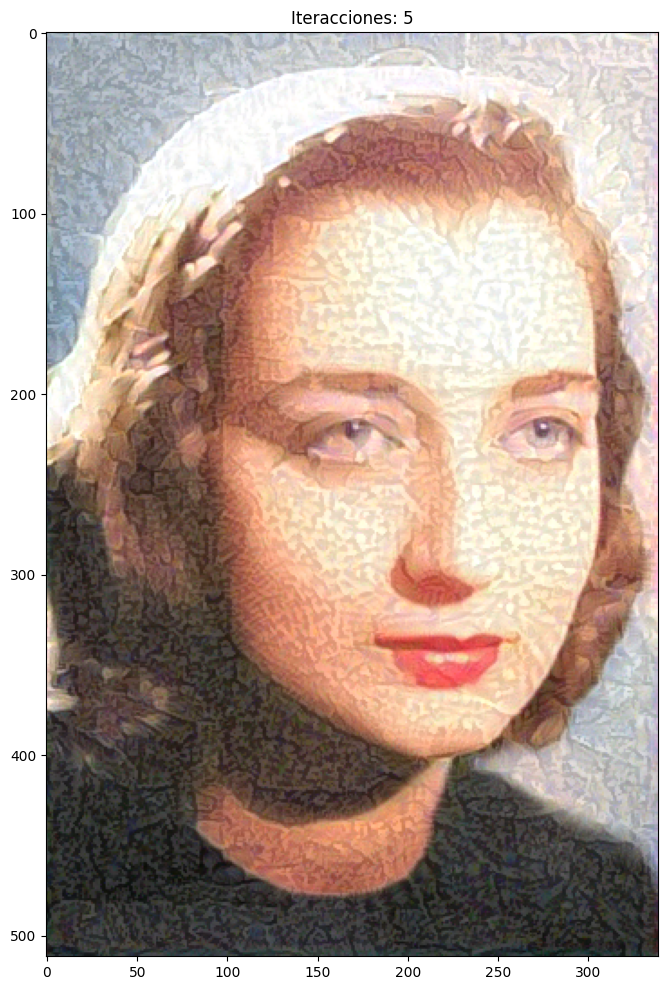

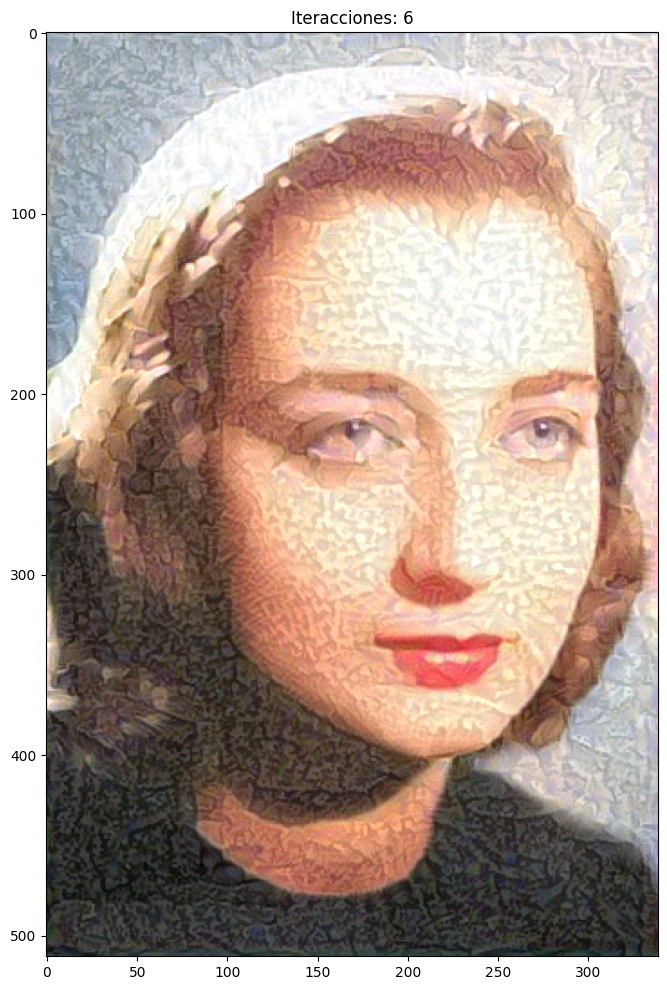

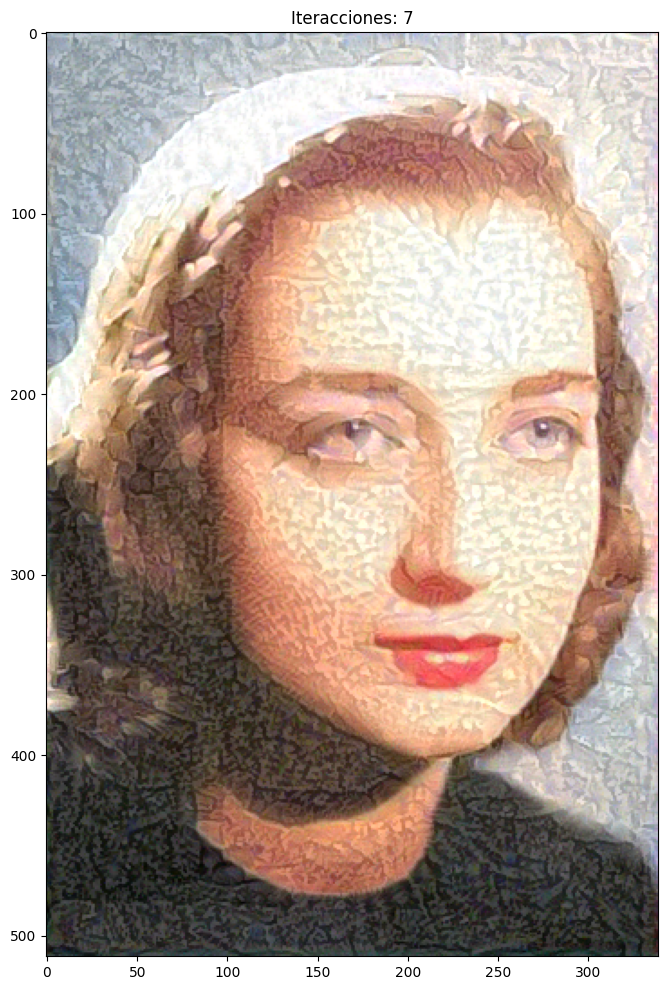

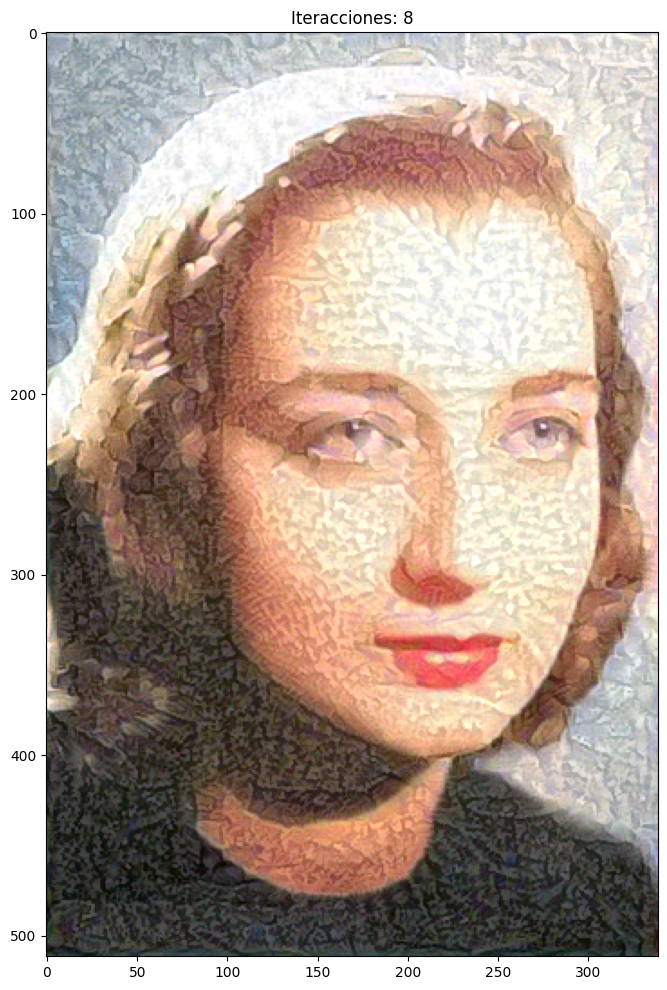

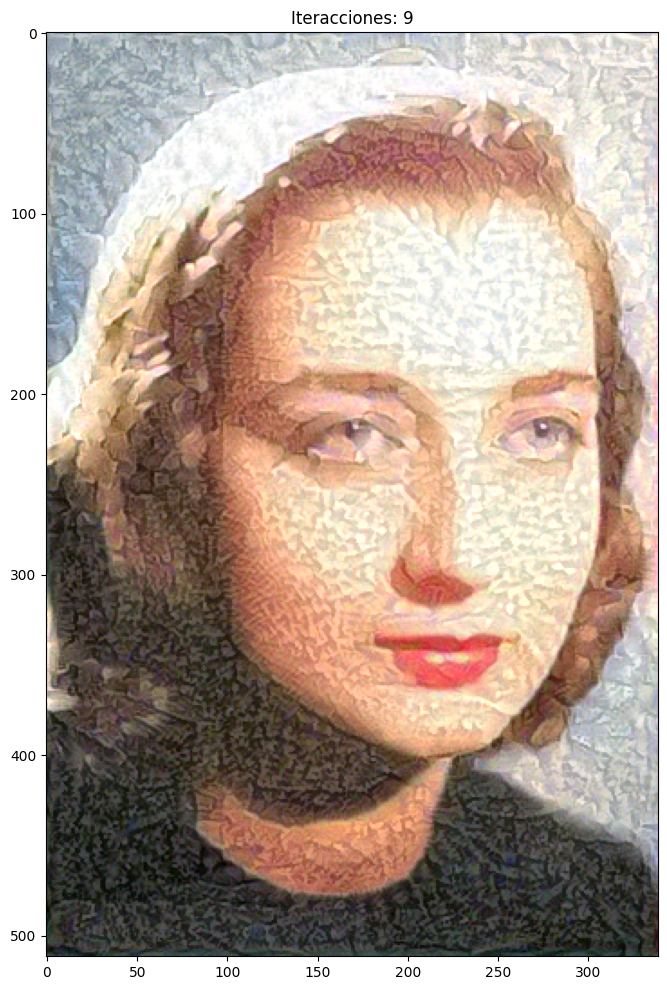

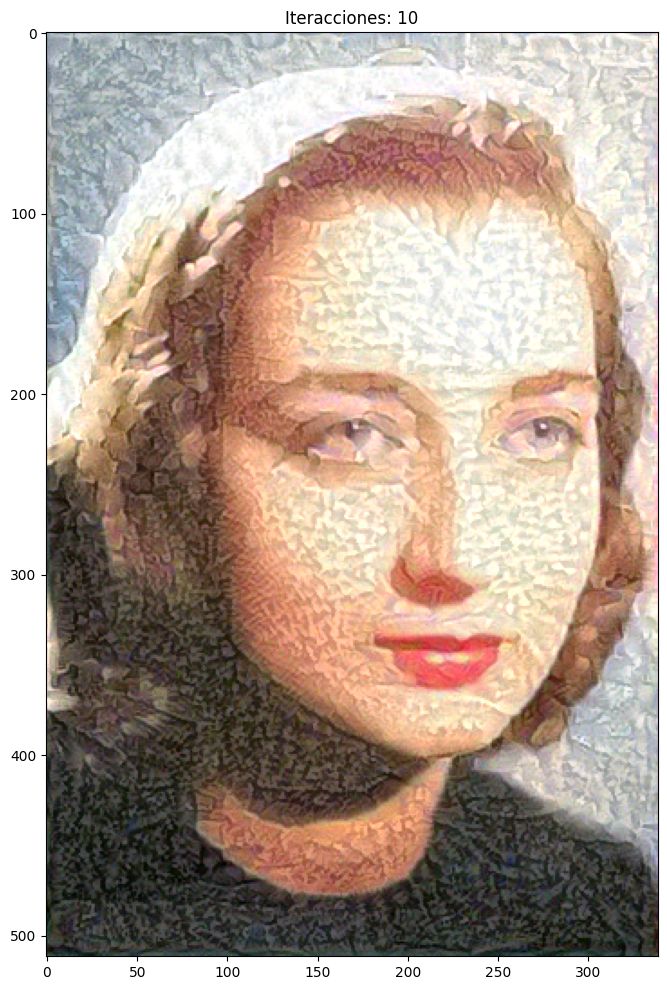

Tiempo Total: 199.4 segundos
El GIF ha sido guardado en: HitaATB0.gif


In [62]:

start = time.time()

# Definir parámetros
epochs = 10
steps_per_epoch = 1

# Lista para almacenar los frames (imágenes)
frames = []

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)  # Actualizar la imagen

    # Obtener la imagen actual y eliminar la dimensión extra
    img = tf.squeeze(image.read_value()).numpy()  # Eliminar la dimensión batch y convertir a numpy
    
    # Mostrar la imagen en el notebook
    plt.imshow(img)
    plt.title("Iteracciones: {}".format(step))
    plt.show()

    # Capturar la imagen mostrada y convertirla en un array de numpy para guardarla
    fig, ax = plt.subplots()
    ax.imshow(img)  # Mostrar la imagen sin 'cmap' para mantener el color
    ax.set_title(f"Iteracciones: {step}")
    ax.axis('off')  # Ocultar los ejes para el GIF
    fig.canvas.draw()

    # Convertir la figura a un array de numpy para agregarla al gif
    frame = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
    frame = frame.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    
    # Agregar el frame a la lista de frames
    frames.append(frame)
    
    plt.close(fig)  # Cerrar la figura para liberar memoria

# Guardar los frames como un GIF animado
output_gif = "HitaATB0.gif"
imageio.mimsave(output_gif, frames, fps=0.5, loop=0)  # Guardar el gif con 0.5 frames por segundo

end = time.time()
print("Tiempo Total: {:.1f} segundos".format(end - start))
print(f"El GIF ha sido guardado en: {output_gif}")

